In [1]:
import pandas as pd
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
%matplotlib inline
import matplotlib.image as mpimg
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('AB_NYC_2019.csv', sep=',')
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
df.shape

(48895, 16)

In [4]:
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [6]:
df.duplicated().sum()
df.drop_duplicates(inplace=True)

In [7]:
df.shape

(48895, 16)

In [8]:
df.isnull().sum()
df.dropna(how='any',inplace=True)
df.info() #.info() function is used to get a concise summary of the dataframe

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38821 entries, 0 to 48852
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              38821 non-null  int64  
 1   name                            38821 non-null  object 
 2   host_id                         38821 non-null  int64  
 3   host_name                       38821 non-null  object 
 4   neighbourhood_group             38821 non-null  object 
 5   neighbourhood                   38821 non-null  object 
 6   latitude                        38821 non-null  float64
 7   longitude                       38821 non-null  float64
 8   room_type                       38821 non-null  object 
 9   price                           38821 non-null  int64  
 10  minimum_nights                  38821 non-null  int64  
 11  number_of_reviews               38821 non-null  int64  
 12  last_review                     

In [9]:
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,3.882100e+04,3.882100e+04,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000
mean,1.810081e+07,6.424582e+07,40.728129,-73.951149,142.332526,5.869220,29.290255,1.373229,5.166611,114.886299
std,1.069372e+07,7.589752e+07,0.054991,0.046693,196.994756,17.389026,48.182900,1.680328,26.302954,129.529950
min,2.539000e+03,2.438000e+03,40.506410,-74.244420,0.000000,1.000000,1.000000,0.010000,1.000000,0.000000
25%,8.721444e+06,7.029525e+06,40.688640,-73.982460,69.000000,1.000000,3.000000,0.190000,1.000000,0.000000
50%,1.887286e+07,2.837092e+07,40.721710,-73.954810,101.000000,2.000000,9.000000,0.720000,1.000000,55.000000
75%,2.756746e+07,1.018905e+08,40.762990,-73.935020,170.000000,4.000000,33.000000,2.020000,2.000000,229.000000
max,3.645581e+07,2.738417e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [10]:
## Exploratory Data Analysis

In [11]:
#Distribution of price

<AxesSubplot:xlabel='price', ylabel='Density'>

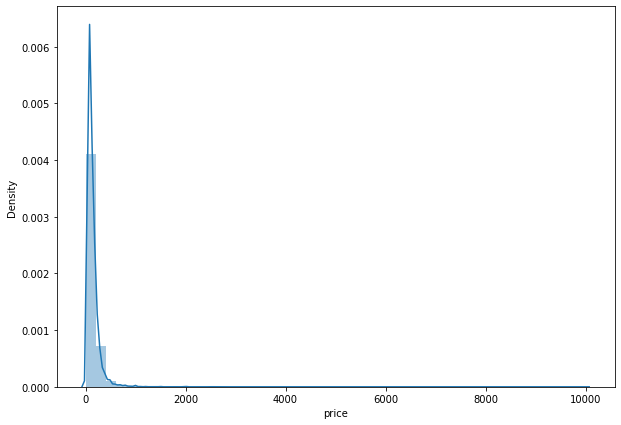

In [12]:
plt.figure(figsize=(10,7))
sns.distplot(df['price'])

In [13]:
#Distribtion of reviews per month

<AxesSubplot:xlabel='reviews_per_month', ylabel='Density'>

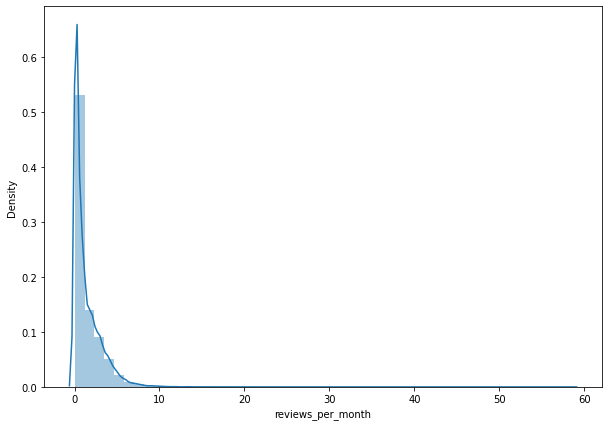

In [14]:
plt.figure(figsize=(10,7))
sns.distplot(df['reviews_per_month'])

In [15]:
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

In [16]:
#Plot of neighborhood group

Text(0.5, 1.0, 'Neighbourhood Group')

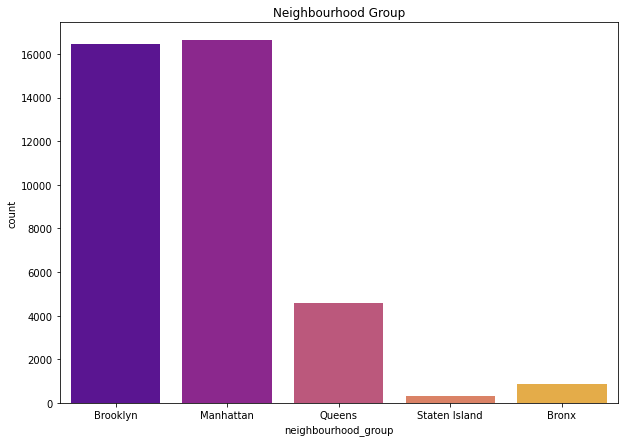

In [17]:
plt.figure(figsize=(10,7))
sns.countplot(data=df, x='neighbourhood_group', palette='plasma')
plt.title('Neighbourhood Group')

In [18]:
#Plot of room type

Text(0.5, 1.0, 'Room Type')

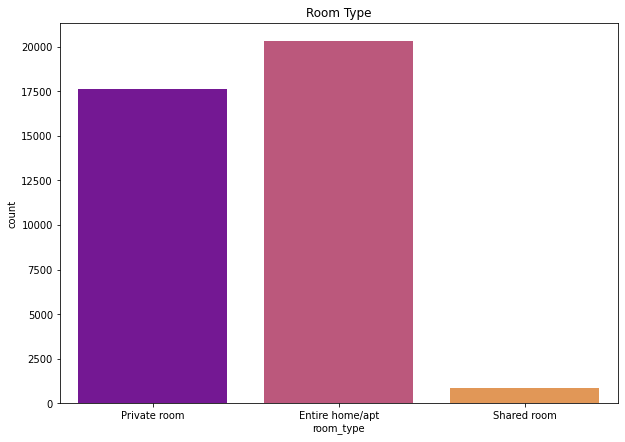

In [19]:
plt.figure(figsize=(10,7))
sns.countplot(data=df, x='room_type', palette='plasma')
plt.title('Room Type')

Text(0.5, 1.0, 'Neighborhood')

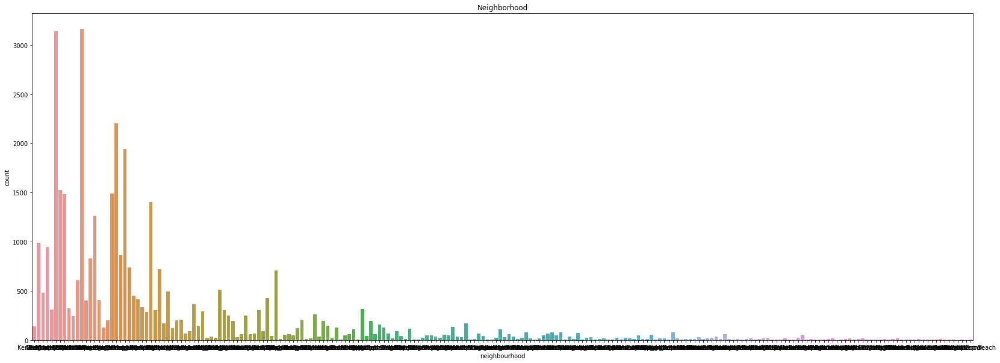

In [20]:
plt.figure(figsize=(28,10))
sns.countplot(data=df, x='neighbourhood')
plt.title('Neighborhood')

In [21]:
#Exploring the relaionship between neigborhood group and the availability

<AxesSubplot:xlabel='neighbourhood_group', ylabel='availability_365'>

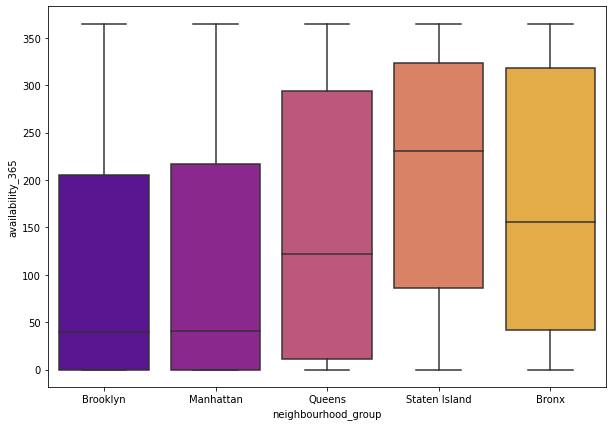

In [22]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df, x='neighbourhood_group', y='availability_365', palette='plasma')

In [23]:
#Exploring the relation between price and neighboorhood

<AxesSubplot:xlabel='price', ylabel='neighbourhood_group'>

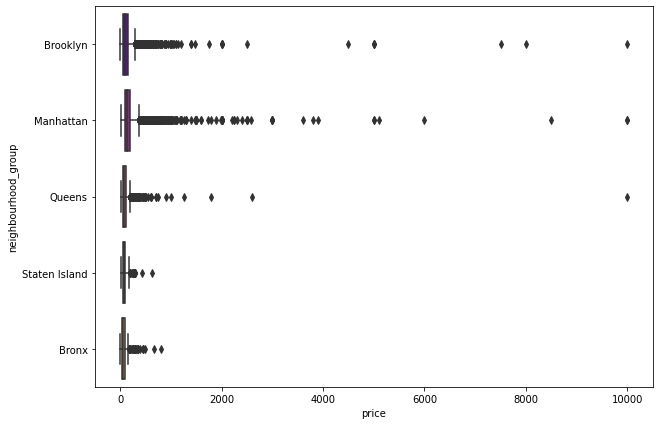

In [24]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df, x='price', y='neighbourhood_group', palette='plasma')

In [25]:
#Exploring the relation between the room tye and number of reviews

<AxesSubplot:xlabel='room_type', ylabel='number_of_reviews'>

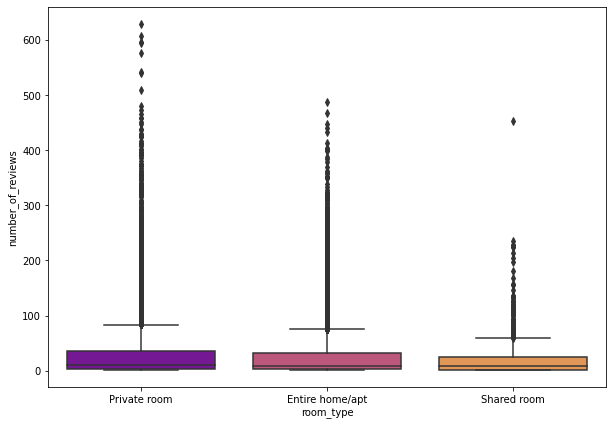

In [26]:
plt.figure(figsize=(10,7))
sns.boxplot(data=df, x='room_type', y='number_of_reviews', palette='plasma')

In [27]:
#Exploring the relation between price ana availability

<Figure size 720x504 with 0 Axes>

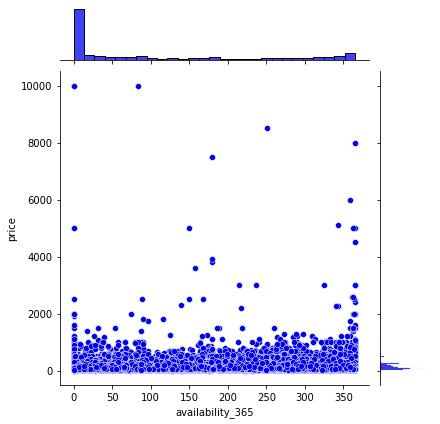

In [28]:
plt.figure(figsize=(10,7))
sns.jointplot(data=df, x='availability_365', y='price', color='blue')

In [29]:
#Exploring the relation between number of reviews and price

<Figure size 720x504 with 0 Axes>

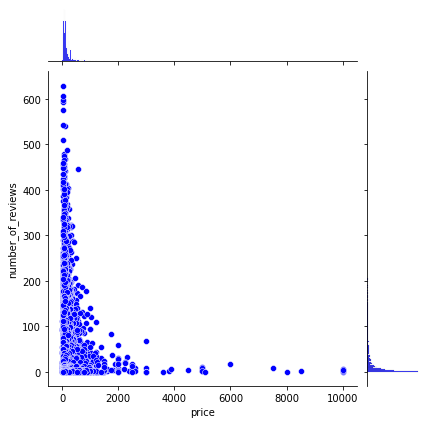

In [30]:
plt.figure(figsize=(10,7))
sns.jointplot(data=df, x='price', y='number_of_reviews', color='blue')

In [31]:
#Plot of number of reviews according to neighborhood group

<AxesSubplot:xlabel='number_of_reviews', ylabel='Count'>

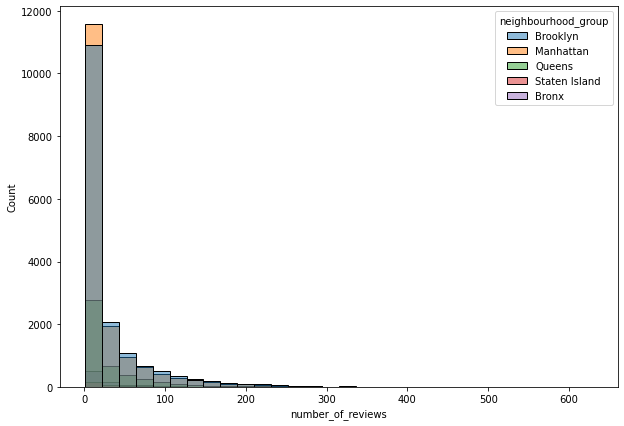

In [32]:
plt.figure(figsize=(10,7))
sns.histplot(data=df, x='number_of_reviews', hue='neighbourhood_group', color='red', bins=30)

In [33]:
#Exploring the correlation between the features 

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

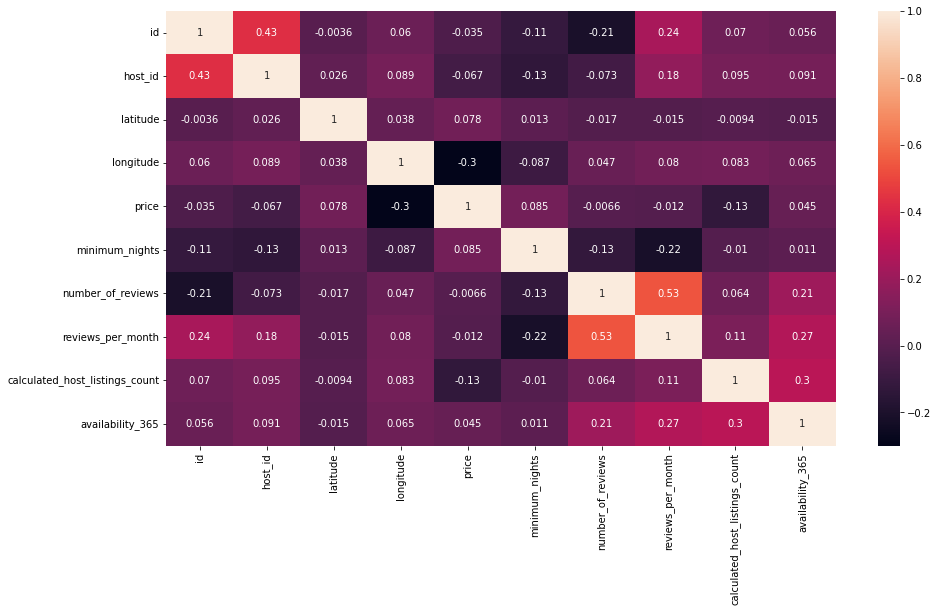

In [34]:
corr = df.corr(method='kendall')
plt.figure(figsize=(15,8))
sns.heatmap(corr, annot=True)
df.columns

In [35]:
## Map of Neighbourhood group

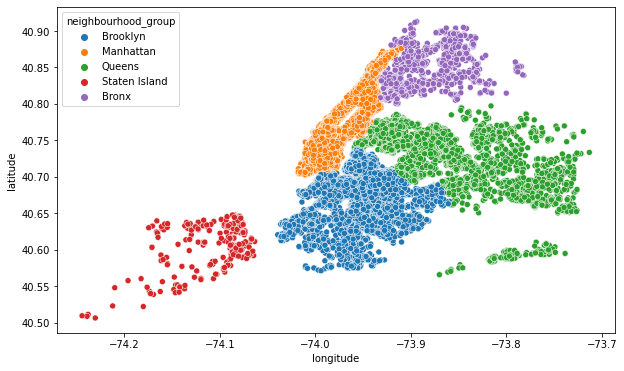

In [36]:
plt.figure(figsize=(10,6))
sns.scatterplot(df.longitude,df.latitude,hue=df.neighbourhood_group)
plt.ioff()

In [37]:
## Map of RoomType group

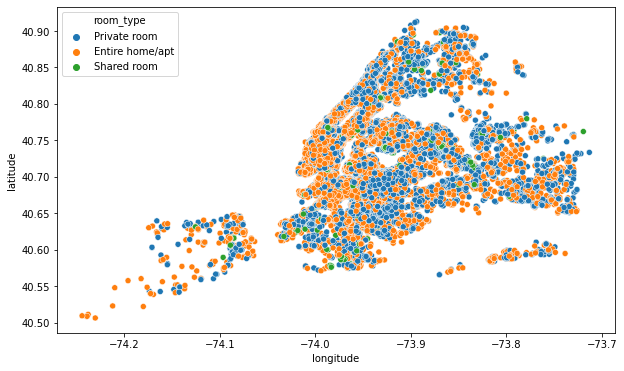

In [38]:
plt.figure(figsize=(10,6))
sns.scatterplot(df.longitude,df.latitude,hue=df.room_type)
plt.ioff()

In [39]:
#Multiple Linear Regression Analysis - prediction of prices 

In [40]:
from sklearn.model_selection import train_test_split

In [41]:
df.drop(['name','latitude','longitude','neighbourhood','number_of_reviews','reviews_per_month'], axis=1, inplace=True)
#examing the changes
df.head(5)
#examing the changes
df.head(5)

,id,host_id,host_name,neighbourhood_group,room_type,price,minimum_nights,last_review,calculated_host_listings_count,availability_365
0,2539,2787,John,Brooklyn,Private room,149,1,2018-10-19,6,365
1,2595,2845,Jennifer,Manhattan,Entire home/apt,225,1,2019-05-21,2,355
3,3831,4869,LisaRoxanne,Brooklyn,Entire home/apt,89,1,2019-07-05,1,194
4,5022,7192,Laura,Manhattan,Entire home/apt,80,10,2018-11-19,1,0
5,5099,7322,Chris,Manhattan,Entire home/apt,200,3,2019-06-22,1,129


In [42]:
df.drop(['host_id', 'host_name'], axis=1, inplace=True)
df.head(5)

,id,neighbourhood_group,room_type,price,minimum_nights,last_review,calculated_host_listings_count,availability_365
0,2539,Brooklyn,Private room,149,1,2018-10-19,6,365
1,2595,Manhattan,Entire home/apt,225,1,2019-05-21,2,355
3,3831,Brooklyn,Entire home/apt,89,1,2019-07-05,1,194
4,5022,Manhattan,Entire home/apt,80,10,2018-11-19,1,0
5,5099,Manhattan,Entire home/apt,200,3,2019-06-22,1,129


In [43]:
#Encode the input Variables
def Encode(df):
    for column in df.columns[df.columns.isin(['neighbourhood_group', 'room_type'])]:
        df[column] = df[column].factorize()[0]
    return df

df_en = Encode(df.copy())

In [44]:
df_en.head()

,id,neighbourhood_group,room_type,price,minimum_nights,last_review,calculated_host_listings_count,availability_365
0,2539,0,0,149,1,2018-10-19,6,365
1,2595,1,1,225,1,2019-05-21,2,355
3,3831,0,1,89,1,2019-07-05,1,194
4,5022,1,1,80,10,2018-11-19,1,0
5,5099,1,1,200,3,2019-06-22,1,129


In [45]:
X = df_en[['id','neighbourhood_group', 'room_type', 'minimum_nights','calculated_host_listings_count', 'availability_365']]
y= df_en['price']

In [46]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [47]:
train_test_split

<function sklearn.model_selection._split.train_test_split(*arrays, test_size=None, train_size=None, random_state=None, shuffle=True, stratify=None)>

In [48]:
#Build the model

In [49]:
from sklearn.linear_model import LinearRegression

In [50]:
lm_model = LinearRegression()

In [51]:
lm_model

LinearRegression()

In [52]:
lm_model.fit(X_train,y_train)

LinearRegression()

In [53]:
lm_model.intercept_

83.66838189722824

In [54]:
lm_model.coef_

array([-5.21035580e-08, -3.53566041e+00,  8.56711261e+01,  7.58410254e-02,
        1.49426365e-01,  1.12909107e-01])

In [55]:
coefficients =pd.DataFrame(lm_model.coef_, X.columns, columns=['columns'])

In [56]:
coefficients

,columns
id,-5.210356e-08
neighbourhood_group,-3.535660e+00
room_type,8.567113e+01
minimum_nights,7.584103e-02
calculated_host_listings_count,1.494264e-01
availability_365,1.129091e-01


In [57]:
#Predictions

In [58]:
lm_predictions = lm_model.predict(X_test)

In [59]:
lm_predictions

array([ 83.67637589, 166.71576627, 112.92265921, ..., 170.14914601,
       188.64418404, 188.3203923 ])

In [60]:
final_predictions= pd.DataFrame({'Id': X_test.id, 'Y_test_real_values':y_test, 'Y-prediction-price': lm_predictions})

In [61]:
final_predictions

,Id,Y_test_real_values,Y-prediction-price
38381,30226855,100,83.676376
17121,13569725,150,166.715766
27203,21501184,55,112.922659
24407,19653554,350,200.344055
136,31902,77,104.065649
...,...,...,...
13353,10032487,115,176.248096
2031,903972,49,113.692110
37984,30020930,150,170.149146
15383,12333456,199,188.644184


In [62]:
final_predictions.to_csv('Final_predictions_LinearRegression_AirBnB.csv', index=False)

In [63]:
X_test['Predicted_price'] = lm_predictions

In [64]:
X_test

,id,neighbourhood_group,room_type,minimum_nights,calculated_host_listings_count,availability_365,Predicted_price
38381,30226855,1,0,4,2,40,83.676376
17121,13569725,1,1,3,1,11,166.715766
27203,21501184,3,0,2,5,355,112.922659
24407,19653554,0,1,2,1,281,200.344055
136,31902,0,0,2,1,178,104.065649
...,...,...,...,...,...,...,...
13353,10032487,1,1,28,1,77,176.248096
2031,903972,1,0,1,3,293,113.692110
37984,30020930,1,1,3,1,49,170.149146
15383,12333456,0,1,2,1,174,188.644184


In [65]:
X_test['Real_test_price'] = y_test

In [66]:
X_test

,id,neighbourhood_group,room_type,minimum_nights,calculated_host_listings_count,availability_365,Predicted_price,Real_test_price
38381,30226855,1,0,4,2,40,83.676376,100
17121,13569725,1,1,3,1,11,166.715766,150
27203,21501184,3,0,2,5,355,112.922659,55
24407,19653554,0,1,2,1,281,200.344055,350
136,31902,0,0,2,1,178,104.065649,77
...,...,...,...,...,...,...,...,...
13353,10032487,1,1,28,1,77,176.248096,115
2031,903972,1,0,1,3,293,113.692110,49
37984,30020930,1,1,3,1,49,170.149146,150
15383,12333456,0,1,2,1,174,188.644184,199


In [67]:
X_test.to_csv('CompleteData-Predictions-LinearRegression-AirBnB-dataset.csv', index=False)

In [68]:
#Evalueation 

In [69]:
from sklearn import metrics

In [70]:
print('MAE:', metrics.mean_absolute_error(y_test, lm_predictions))

MAE: 66.24583784508798


In [71]:
print('MSE:', metrics.mean_squared_error(y_test, lm_predictions))

MSE: 29560.84583056101


In [72]:
print('RMSE:', np.sqrt(metrics.mean_absolute_error(y_test, lm_predictions)))

RMSE: 8.139154614890172


In [88]:
r2_score=lm_model.score(X,y)
print('R^2 score:',r2_score)

R^2 score: 0.06154062757464507


In [74]:
#Additional visualizations 

In [75]:
from plotly import version

In [76]:
import cufflinks as cf

In [77]:
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot, plot

In [78]:
init_notebook_mode(connected=True)

In [79]:
cf.go_offline()

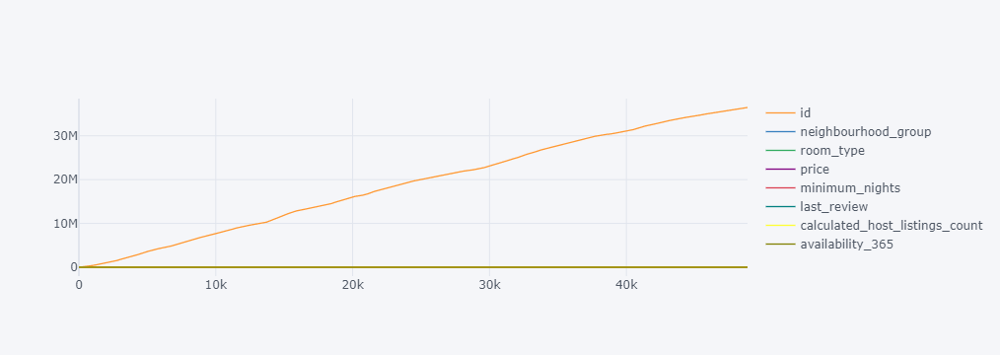

In [80]:
df_en.iplot()

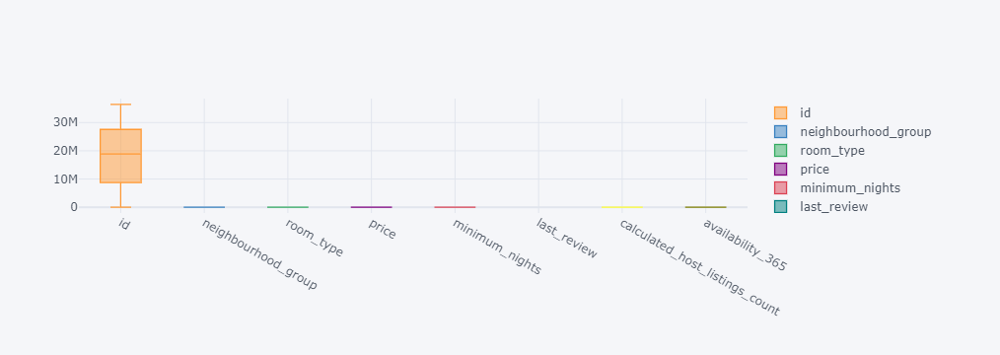

In [81]:
df_en.iplot(kind='box')

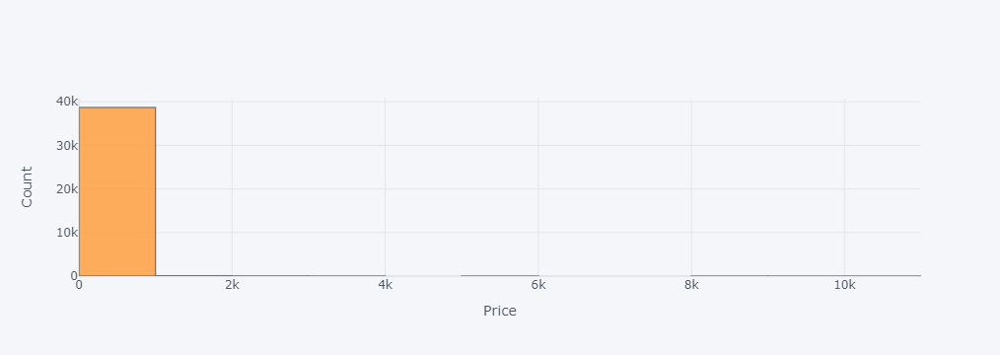

In [82]:
df_en['price'].iplot(kind='hist', bins=10, xTitle='Price', yTitle='Count')

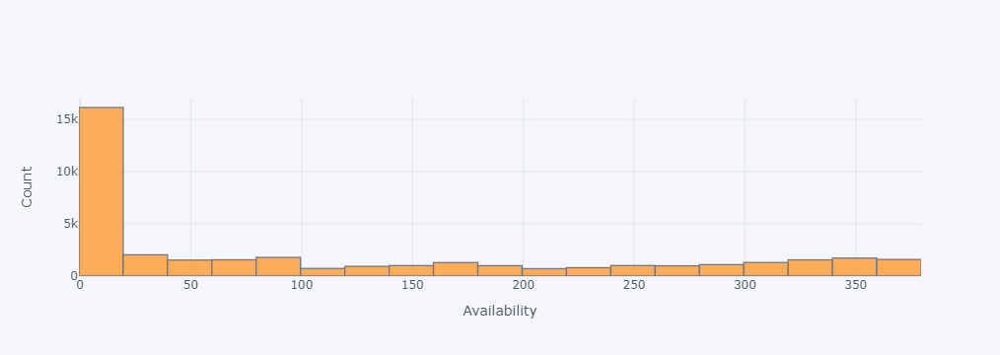

In [83]:
df_en['availability_365'].iplot(kind='hist', bins=20, xTitle='Availability', yTitle='Count')

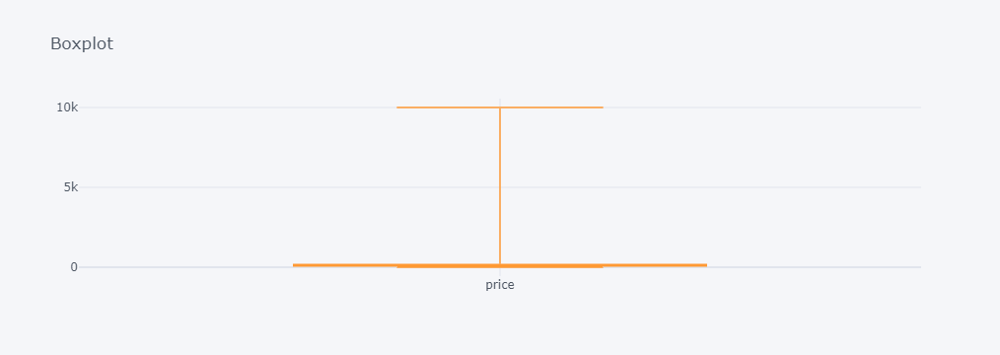

In [84]:
df_en['price'].iplot(kind='box', x='price', y='Value', title='Boxplot')

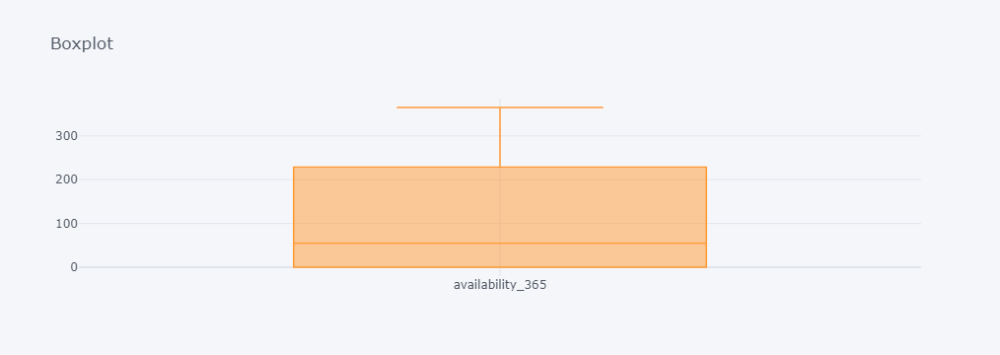

In [85]:
df_en['availability_365'].iplot(kind='box', x='availability_365', y='Value', title='Boxplot')

<AxesSubplot:xlabel='price'>

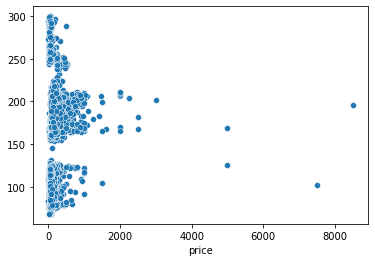

In [86]:
sns.scatterplot(y_test, lm_predictions)